<img src="https://xarray.dev/dataset-diagram-logo.png"
     align="right"
     width="30%"/>

# Geospatial 

## Create Cluster

In [1]:
import coiled

cluster = coiled.Cluster(
    n_workers=10,
    backend_options={'region': 'us-east-1'},
) 
client = cluster.get_client()


╭───────────────────────────────────────── Coiled Cluster ─────────────────────────────────────────╮
│            https://cloud.coiled.io/clusters/188623/overview?account=dask-engineering             │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
╭─────────────────── Overview ───────────────────╮╭──────────────── Configuration ─────────────────╮
│                                                ││                                                │
│ Cluster Name: dask-engineering-e00faacc-8      ││ Region: us-east-1                              │
│                                                ││                                                │
│ Scheduler Status: started                      ││ Scheduler Instance Type: t3.xlarge             │
│                                                ││                                                │
│ Dashboard Address:                             ││ Worker Instance Type(s): t3.xlarge (10)        │
│ ]8;id=444001;https://cluster-leynp.dask.host?token=kjLojBWQQkNUSGJ7\https://cluster-leynp.dask.host?token=kjLojBWQ]8;;\ ││                                                │
│ ]8;id=444001;https://cluster-leynp.dask.host?token=kjLojBWQQkNUSGJ7\QkNUSGJ7]8;;\                                       ││ Workers Requested: 10                          │
│                                                ││                                                │
╰────────────────────────────────────────────────╯╰────────────────────────────────────────────────╯
╭─────────────────────────────────── (2023/04/07 13:55:55 CDT) ────────────────────────────────────╮
│                                                                                                  │
│                    Most of your workers have arrived. Cluster ready for use.                     │
│                                                                                                  │
│                                                                                                  │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯

## Load Data

In [6]:
# code used to produce the image above ^
import xarray as xr
import geogif
import coiled

ds = xr.open_dataset(
    "s3://era5-pds/zarr/2020/01/data/eastward_wind_at_100_metres.zarr",
    engine="zarr",
    chunks={},
).persist()
ds

## Analyze

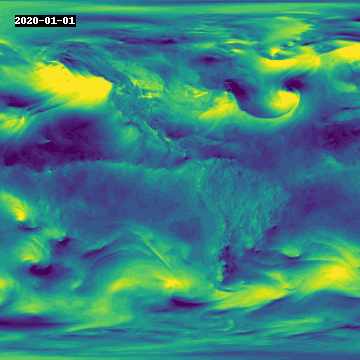

In [7]:
hourly_wind = (
    ds['eastward_wind_at_100_metres']
    .sel(lon=slice(180, None))
    .coarsen(lat=2, lon=2, boundary='trim')
    .mean()
)

geogif.dgif(hourly_wind).compute()